In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import models, transforms, utils
import time
import copy
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import torchvision.models as models
swin_v2_s = models.swin_v2_s(pretrained=True)

Downloading: "https://download.pytorch.org/models/swin_v2_s-637d8ceb.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_s-637d8ceb.pth
100%|██████████| 191M/191M [00:00<00:00, 205MB/s]


In [ ]:
class CustomMyDataset(Dataset):
    def __init__(self, csv_file, root_dir, transform=None):
        self.data_frame = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.data_frame)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        img_name = os.path.join(self.root_dir + self.data_frame.iloc[idx, 0] + '.jpg')
        image = io.imread(img_name)
        label = self.data_frame.iloc[idx, 1:]
        label = np.array(label)
        label = label.astype('float')

        if self.transform:
            image = self.transform(image).type('torch.FloatTensor')
            label = torch.from_numpy(label)

        return image, label

In [ ]:
data_transforms = {
    'train': transforms.Compose([
        transforms.ToTensor(),
        transforms.RandomResizedCrop([600,450]),
        transforms.RandomHorizontalFlip(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.ToTensor(),
        transforms.Resize([600,450]),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}



In [ ]:
train_data_dir = '/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Training_Input/ISIC2018_Task3_Training_Input/'
valid_data_dir = '/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Validation_Input (1)/ISIC2018_Task3_Validation_Input/'
test_data_dir = '/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Test_Input/ISIC2018_Task3_Test_Input/'
train_groundtruth = "/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Training_GroundTruth/ISIC2018_Task3_Training_GroundTruth/ISIC2018_Task3_Training_GroundTruth.csv"
valid_groundtruth = "/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Validation_GroundTruth/ISIC2018_Task3_Validation_GroundTruth/ISIC2018_Task3_Validation_GroundTruth.csv"
test_groundtruth = '/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Test_GroundTruth (1)/ISIC2018_Task3_Test_GroundTruth/ISIC2018_Task3_Test_GroundTruth.csv'
train_val_dataset_csv = {
    'train': train_groundtruth,
    'val': valid_groundtruth
}
train_val_dataset_dir = {
    'train': train_data_dir,
    'val': valid_data_dir
}
train_val_datasets = {x: CustomMyDataset(train_val_dataset_csv[x], train_val_dataset_dir[x],transform=data_transforms[x]) 
            for x in ['train', 'val']}
train_val_dataloaders = {x: torch.utils.data.DataLoader(train_val_datasets[x], batch_size=50,
                                             shuffle=True, num_workers=4, drop_last = True)
              for x in ['train', 'val']}
dataset_sizes = {x: len(train_val_datasets[x]) for x in ['train', 'val']}
testdataset = CustomMyDataset(test_groundtruth , test_data_dir,transform=data_transforms['val'])
testdataloader = torch.utils.data.DataLoader(testdataset, batch_size = 50, shuffle=True, num_workers=4, drop_last = True)
# class_names = datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
def train_model(dataloaders, model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0.0
              # Iterate over data.
            for inputs, labels in dataloaders[phase]:
              inputs = inputs.to(device)
              labels = labels.to(device)
              # zero the parameter gradients
              optimizer.zero_grad()

              # forward
              # track history if only in train
              with torch.set_grad_enabled(phase == 'train'):
                outputs = model(inputs)
                _, preds = torch.max(outputs, -1)
                loss = criterion(outputs, labels)

                # backward + optimize only if in training phase
                if phase == 'train':
                      loss.backward()
                      optimizer.step()

                # statistics
                _, label = torch.max(labels, -1)
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == label)
            if phase == 'train':
                 scheduler.step()


            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

In [ ]:
import torch.nn as nn
import torchvision.models as models
class swin_v2_s_model(torch.nn.Module):
    def __init__(self, n_class):
        super(swin_v2_s_model, self).__init__()
        swinv2s = models.swin_v2_s(pretrained=True)
        base_layers = list(swinv2s.children())
        self.backbone = nn.Sequential(*base_layers[:5])
        for param in self.backbone.parameters():
          param.requires_grad = False
        self.cls = base_layers[5]
        num_ftrs = self.cls.in_features
        self.cls = nn.Linear(num_ftrs,n_class)
    def forward(self, x):
        x = self.backbone(x)
        x = self.cls(x)     
        return x

In [ ]:
model_ft = swin_v2_s_model(7)
#Finetuningmodel_ft = swin_v2_s_model(7)
#Finetuning
model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.01, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)
model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.01, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [ ]:
#Train 5 epochs
model_ft = train_model(train_val_dataloaders, model_ft, criterion, optimizer_ft, exp_lr_scheduler, num_epochs=20)

Epoch 0/19
----------
train Loss: 0.8628 Acc: 0.7061
val Loss: 0.6042 Acc: 0.5544

Epoch 1/19
----------
train Loss: 0.7243 Acc: 0.7379
val Loss: 0.5512 Acc: 0.6010

Epoch 2/19
----------
train Loss: 0.6904 Acc: 0.7553
val Loss: 0.6094 Acc: 0.5648

Epoch 3/19
----------
train Loss: 0.6611 Acc: 0.7643
val Loss: 0.5341 Acc: 0.6269

Epoch 4/19
----------
train Loss: 0.6645 Acc: 0.7584
val Loss: 0.6156 Acc: 0.5907

Epoch 5/19
----------
train Loss: 0.6371 Acc: 0.7705
val Loss: 0.5748 Acc: 0.5803

Epoch 6/19
----------
train Loss: 0.6254 Acc: 0.7737
val Loss: 0.6821 Acc: 0.5233

Epoch 7/19
----------
train Loss: 0.6073 Acc: 0.7845
val Loss: 0.5678 Acc: 0.5907

Epoch 8/19
----------
train Loss: 0.6100 Acc: 0.7822
val Loss: 0.5443 Acc: 0.6114

Epoch 9/19
----------
train Loss: 0.6025 Acc: 0.7837
val Loss: 0.5250 Acc: 0.6269

Epoch 10/19
----------
train Loss: 0.6049 Acc: 0.7828
val Loss: 0.5621 Acc: 0.6010

Epoch 11/19
----------
train Loss: 0.6013 Acc: 0.7811
val Loss: 0.5695 Acc: 0.5855

Ep

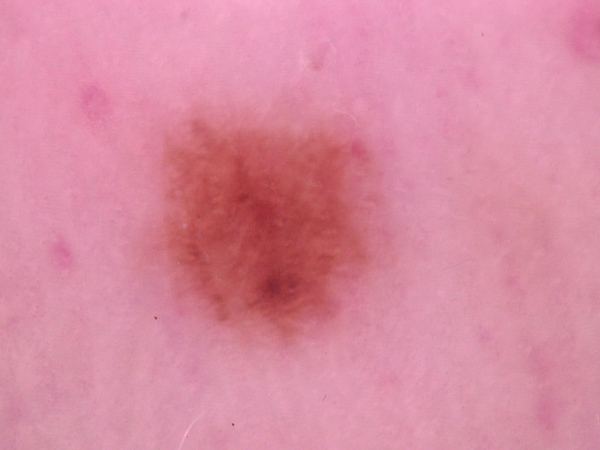

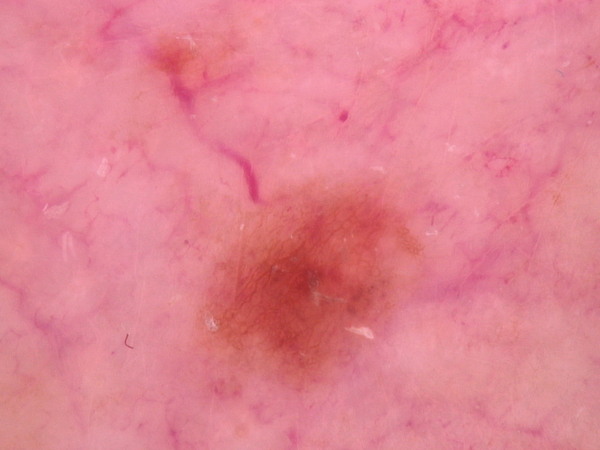

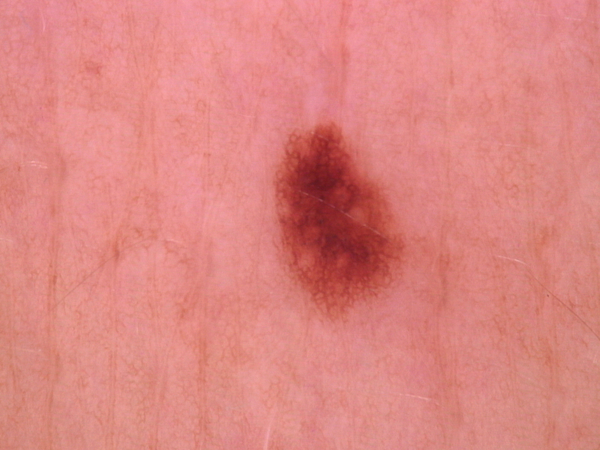

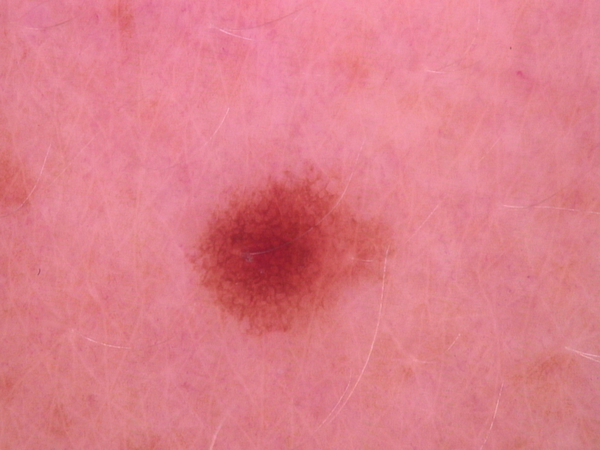

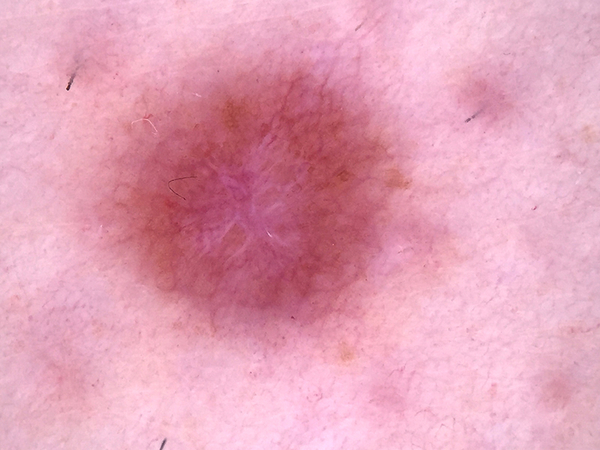

...

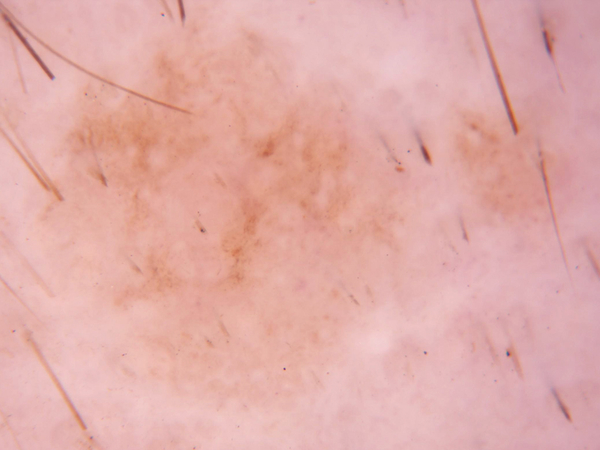

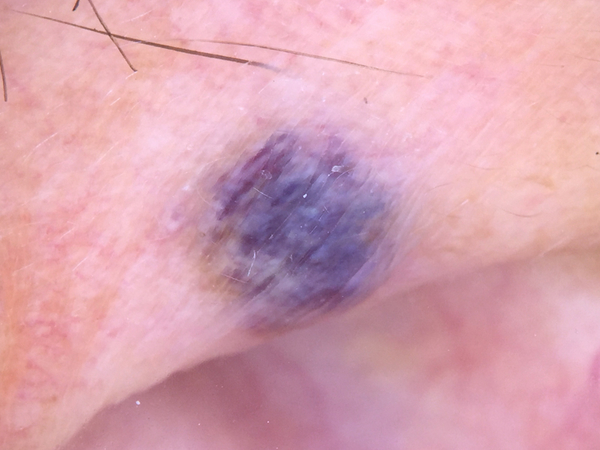

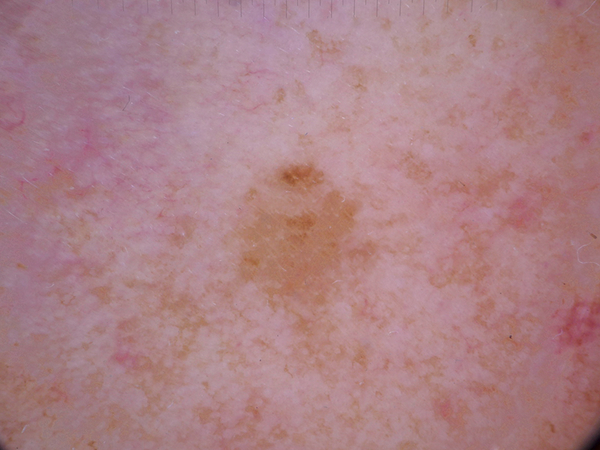

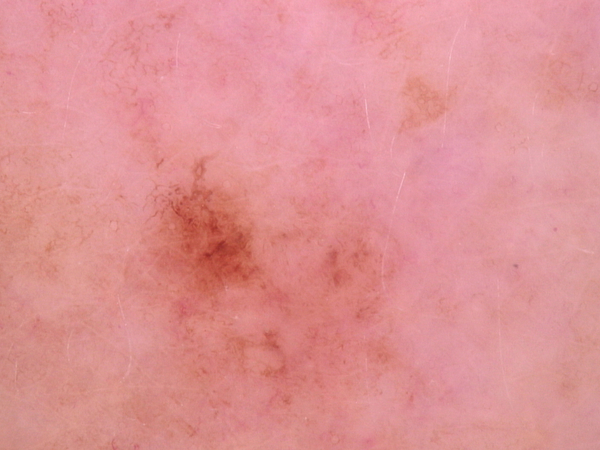

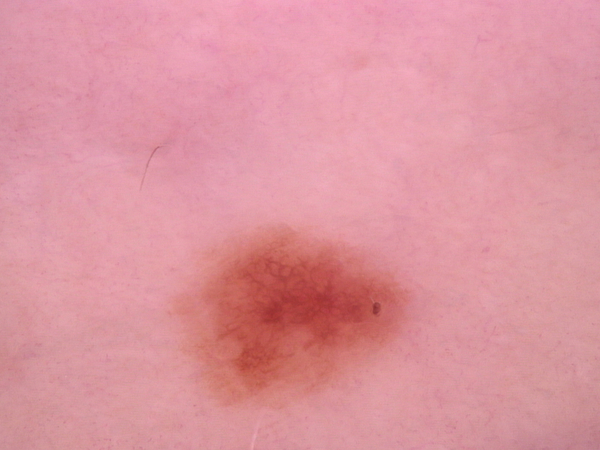

Buffered data was truncated after reaching the output size limit.

In [ ]:
import os
from IPython.display import Image

for file_name in os.listdir("/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Test_Input/ISIC2018_Task3_Test_Input"):
  if file_name.endswith(".jpg"):
    file_path = os.path.join("/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Test_Input/ISIC2018_Task3_Test_Input", file_name)
    display(Image(filename=file_path))

In [ ]:
test_data_dir = '/content/drive/MyDrive/AI_T6/ISIC2018_Task3_Test_Input/ISIC2018_Task3_Test_Input/'
testdataset = CustomMyDataset(test_groundtruth , test_data_dir,transform=data_transforms['val'])
testdataloader = torch.utils.data.DataLoader(testdataset, batch_size = 10, shuffle=True, num_workers=4)

In [ ]:
import torch
import torch.nn.functional as F
num_correct = 0.0
num_samples = 0.0
predictions = []
for inputs, labels in testdataloader:
  model_ft.eval()
  inputs = inputs.to(device)
  labels = labels.to(device)
  scores = model_ft(inputs)
  _, prediction = torch.max(scores, -1)
  _, label = torch.max(labels, -1)
  for i in range(0,inputs.size(0)):
    predictions.append(prediction[i])
  ## print(predictions)
  
  model_ft.train()

In [ ]:
predictions_onehot = []
for i in range(0,len(predictions)):
  predictions_onehot.append(F.one_hot(predictions[i], num_classes = 7))

In [ ]:
from google.colab import files
upploaded = files.upload()

In [ ]:
testcsv = pd.read_csv(test_groundtruth)
label_image = testcsv.iloc[0,0]
print(label_image)

In [ ]:
import csv
# Define the filename and open the CSV file
filename = 'Test.csv'
with open(filename, mode='w', newline='') as file:
  writer = csv.writer(file)
  # Write the headers for the two columns
  writer.writerow(['image', 'MEL', 'BCC', 'BCC', 'AKIEC', 'BKL', 'DF', 'VASC',])
  for i in range(0,len(predictions_onehot)):
    writer.writerow([testcsv.iloc[i,0],predictions_onehot[i][0].item(),predictions_onehot[i][1].item(),predictions_onehot[i][2].item(),predictions_onehot[i][3].item(),predictions_onehot[i][4].item(),predictions_onehot[i][5].item(),predictions_onehot[i][6].item()])

In [ ]:
files.download("Test.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>